# Исследование рынка заведений общественного питания в Москве

**ЦЕЛЬ ПРОЕКТА:**  

Провести исследование рынка Москвы среди заведений общественного питания, найти интересные особенности и презентовать полученные результаты, которые в будущем помогут инвесторам определиться с выбором подходящего месторасположения заведения.

**ОПИСАНИЕ ДАННЫХ:**   

**name**  — название заведения  
**address** — адрес заведения  
**category** — категория заведения, например «кафе», «пиццерия» или «кофейня»    
**hours** — информация о днях и часах работы  
**lat** — широта географической точки, в которой находится заведение   
**lng** — долгота географической точки, в которой находится заведение  
**rating** — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0)   
**price** — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее        
**avg_bill** — строка, которая хранит среднюю стоимость заказа в виде диапазона, например:      
*«Средний счёт: 1000–1500 ₽»;  
«Цена чашки капучино: 130–220 ₽»;  
«Цена бокала пива: 400–600 ₽».  
и так далее;*  
**middle_avg_bill** — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»:        
*Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.  
Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.  
Если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт.*       
**middle_coffee_cup** — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»:  
*Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.  
Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.  
Если значения нет или оно не начинается с подстроки «Цена одной чашки капучино», то в столбец ничего не войдёт.*   
**chain** — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки):    
*0 — заведение не является сетевым   
1 — заведение является сетевым*    
**district** — административный район, в котором находится заведение, например Центральный административный округ    
**seats** — количество посадочных мест  


## ШАГ 1. Загрузка данных, изучение общей информации

In [1]:
# Импортируем базовые библиотеки
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
from plotly import graph_objects as go

# импортируем карту и маркер
from folium import Map, Marker

# импортируем кластер
from folium.plugins import MarkerCluster


In [2]:
# Скачаем датасет и сохраним его в переменную
data = pd.read_csv('/datasets/moscow_places.csv')
#data.head()

In [3]:
# Выводим для ознакомления основную информацию о датафрейме (количество и названия столбцов, ненулевые значения, тип данных)
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


* В датасете всего 8406 строк.  
* Названия столбцов выглядят хорошо.  
* Много пропусков в столбцах:  
    - hours
    - price
    - avg_bill
    - middle_avg_bill 
    - middle_coffee_cup
    - seats  
* На первый взгляд в столбце seats неверный тип данных. Однако число посадочных мест вполне может быть дробным, поскольку рассчитывается как площадь помещения, деленная на 2 кв.м (норма площади на человека).  
В столбце seats отавляем тип данных float.

Предобработкой данных займемся на следующем шаге. 

In [4]:
# Посчитаем, сколько уникальных зведений представлено
data['name'].nunique()

5614

Всего в датасете представлено 5614 уникальных заведений общественного питания.

## ШАГ 2. Предобработка данных.

### Дубликаты

In [5]:
data.duplicated().sum()

0

Явных дубликатов в датасете нет.

### Пропуски

В столбцах hours, price, avg_bill, middle_avg_bill, middle_coffee_cup и seats есть пропуски.

In [6]:
# Посчитаем число пропущенных значений
print('Количество пропусков в столбце hours - ', data['hours'].isna().sum())
print('Количество пропусков в столбце price - ', data['price'].isna().sum())
print('Количество пропусков в столбце avg_bill - ', data['avg_bill'].isna().sum())
print('Количество пропусков в столбце middle_avg_bill - ', data['middle_avg_bill'].isna().sum())
print('Количество пропусков в столбце middle_coffee_cup - ', data['middle_coffee_cup'].isna().sum())
print('Количество пропусков в столбце seats - ', data['seats'].isna().sum())

Количество пропусков в столбце hours -  536
Количество пропусков в столбце price -  5091
Количество пропусков в столбце avg_bill -  4590
Количество пропусков в столбце middle_avg_bill -  5257
Количество пропусков в столбце middle_coffee_cup -  7871
Количество пропусков в столбце seats -  3611


Видим очень много пропусков.   

В столбцах с типом object заменим пропуски на unknown.  

In [7]:
# Заменим пропуски на unknown
data['hours'] = data['hours'].fillna('unknown')

In [8]:
# Заменим пропуски на unknown
data['price'] = data['price'].fillna('unknown')

In [9]:
# Заменим пропуски на unknown
data['avg_bill'] = data['avg_bill'].fillna('unknown')

В столбце seats заменим пропуски на ноль, предположив, что пропуски означают отсутствие посадочных мест в заведении (например, булочные или фаст-фуд на вынос).  

In [10]:
# Заменим пропуски на ноль
data['seats'] = data['seats'].fillna(0)

В столбцах middle_avg_bill и middle_coffee_cup не будем заполнять пропуски, оставим как есть - будем работать с тем объемом данных, который имеется. 

In [11]:
# Проверим результат замены пропусков
data.isna().sum()

name                    0
category                0
address                 0
district                0
hours                   0
lat                     0
lng                     0
rating                  0
price                   0
avg_bill                0
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                   0
dtype: int64

### Аномалии и выбросы

Посмотрим на аномалии в столбце seats.  
Заведение может быть без посадочных мест, но верхняя граница должна быть разумной.  
Самые большие рестораны Москвы вмещают порядка 500 гостей при рассадке и до 1000 на фуршете.  

In [12]:
# Посмотрим на 30 самых вместительных заведений в датасете
data.sort_values(by='seats', ascending=False)['seats'].head(30)

# Посчитаем количество заведений с числом посадочных мест больше 600 (берем с запасом)
print('Количество заведений с числом посадочных мест > 600 -', data.query('seats > 600')['name'].count())

# Найдем максимальное число посадочных мест
print('Максимальное число посадочных мест -', data['seats'].max())

Количество заведений с числом посадочных мест > 600 - 53
Максимальное число посадочных мест - 1288.0


В датасете присутствует 53 заведения с числом посадочных мест больше 600 - это явные выбросы.  
Удалять целые строки из датасета мы не будем, но учтем этот нюанс при дальнейшей работе со столбцом seats. 

In [13]:
# Создадим столбец street с названиями улиц из столбца с адресом
data['street_name'] = data['address'].apply(lambda x: x.split(',')[1])
#data.head()

In [14]:
# Ещё один способ создать столбец с улицами
def get_street(row):
    return row.split(',')[1]

data['street_name'] = data['address'].apply(get_street)
#data.head()

In [15]:
# Создадим столбец is_24/7 с обозначением, что заведение работает ежедневно и круглосуточно (24/7):
# логическое значение True — если заведение работает ежедневно и круглосуточно
# логическое значение False — в противоположном случае

data['is_24/7'] = data['hours'].str.contains('круглосуточно') & data['hours'].str.contains('ежедневно')
#data.head()

Посмотрим на выбросы и аномалии в столбце middle_coffee_cup.

In [16]:
data['middle_coffee_cup'].unique()

array([  nan,  170.,  145.,  150.,  180.,  120.,  100.,  256.,  160.,
        250.,  165.,  149.,  135.,  220.,  175.,  195.,   60.,  214.,
         75.,   89.,   95.,  204.,   90.,  140.,  125.,  162.,  155.,
        154.,  297.,  205.,  124.,  200.,  190.,  134.,  139.,  287.,
        225.,  230.,  237.,  290.,  254.,  279.,  174.,  179.,  295.,
        245.,  105.,  285.,  270.,   84.,  127.,   80.,  112.,  185.,
        210.,  325.,  159.,  215.,  110.,  266.,  242.,  137.,  255.,
        240.,  217.,  315.,  130.,  167.,  169.,  235., 1568.,   79.,
        260.,  300.,  291.,  275.,  115.,  328.,   94.,  265.,  184.,
        229.,  164.,  172.,  259.,  246.,  199.,  138.,  375.,  189.,
        320.,  197.,  227.,  102.,  119.,  144.,  129.])

Самое дорогое кофе стоит 1568 рублей - это значение сильно отличается от остальных, т.е. является выбросом.  

Как и в случае с посадочными местами, удалять целые строки из датасета мы не будем, но учтем этот нюанс при дальнейшей работе со столбцом middle_coffee_cup.

**Вывод (шаг 3):**

Проведена следующая предобработка данных:
- проверили на наличие дубликатов 
- заменили пропуски на unknown в столбцах с типом object 
- заменили пропуски на ноль в столбце seats
- проверили аномалии и выбросы в столбцах middle_coffee_cup и seats
- создали новый столбец street_name с названием улицы  
- создали новый столбец is_24/7 с обозначением, что заведение работает ежедневно и круглосуточно 

## ШАГ 3. Анализ данных.

### Посмотрим, какие категории заведений представлены в данных? Исследуем количество объектов общественного питания по категориям: рестораны, кофейни, пиццерии, бары и так далее. Построим визуализации. Ответим на вопрос о распределении заведений по категориям.  

#### Посмотрим, какие категории заведений представлены в данных

In [17]:
# Выведем уникальные категории и посчитаем их количество
print(data['category'].unique())
print()
print('Всего категорий: ', data['category'].nunique())

['кафе' 'ресторан' 'кофейня' 'пиццерия' 'бар,паб' 'быстрое питание'
 'булочная' 'столовая']

Всего категорий:  8


#### Исследуем количество объектов общественного питания по категориям.

In [18]:
# Посчитаем абсолютное число заведений каждой категории
data_category = data['category'].value_counts().reset_index().rename(columns={'index':'category_name', 'category':'count'})

# Создадим столбец, в котром посчитаем долю заведений каждой категории
data_category['share, %'] = (data_category['count']*100 / data['name'].count()).round()
data_category

,category_name,count,"share, %"
0,кафе,2378,28.0
1,ресторан,2043,24.0
2,кофейня,1413,17.0
3,"бар,паб",765,9.0
4,пиццерия,633,8.0
5,быстрое питание,603,7.0
6,столовая,315,4.0
7,булочная,256,3.0


#### Визуализируем

In [19]:
# Cтроим столбчатую диаграмму 
fig = px.bar(data_category, # загружаем данные 
             x='category_name', # указываем столбец с данными для оси X
             y='share, %', # указываем столбец с данными для оси Y
             text='share, %', # добавляем аргумент, который отобразит текст с информацией о количестве заведений внутри столбца график
             hover_data=['count']) # добавляем аргумент, чтобы при наведении на столбец графика 
                                   # отображалось абсолютное число заведений в столбце count.

# Оформляем график
fig.update_layout(title='РАСПРЕДЕЛЕНИЕ ЗАВЕДЕНИЙ ПО КАТЕГОРИЯМ',
                  xaxis_title='Категория',
                  yaxis_title='Доля, %',
                  height=500, 
                  width=700)
# выводим график
fig.show() 



В датасете больше всего кафе 28%, ресторанов 24% и кофеен 17%, очень мало столовых и булочных.  

### Исследуем количество посадочных мест в завдениях по категориям: рестораны, кофейни, пиццерии, бары и так далее. Построим визуализации. Проанализируем результаты и сделаем выводы.

In [20]:
# Сделаем срез данных, исключив аномальные значения в столбце seats
seats_filtered = data.query('seats <= 600')

# Сгруппируем данные по категориям и посчитаем сдеднее число мест, характерное для каждой категории
# Считаем средне, а не медиану, т.к. "верхние" аномалии уже удалены из расчетов
groupped_category_seats = seats_filtered .groupby('category').agg(seats_count =('seats', 'mean')) \
.sort_values(by='seats_count', ascending=False).reset_index().round()

groupped_category_seats

,category,seats_count
0,ресторан,71.0
1,"бар,паб",67.0
2,пиццерия,59.0
3,быстрое питание,56.0
4,кофейня,53.0
5,булочная,49.0
6,столовая,46.0
7,кафе,46.0


In [21]:
# Cтроим столбчатую диаграмму 
fig = px.bar(groupped_category_seats, # загружаем данные 
             x='category', # указываем столбец с данными для оси X
             y='seats_count', # указываем столбец с данными для оси Y
             text='seats_count') # добавляем аргумент, который отобразит текст с информацией
                                 # о количестве заведений внутри столбца графика
            
# Оформляем график
fig.update_layout(title='Среднее число посадочных мест для каждой категории заведения',
                  xaxis_title='Категория',
                  yaxis_title='Число посадочных мест',
                  height=500, 
                  width=700)
# выводим график
fig.show() 

In [22]:
# Посчитаем медиану по столбцу seats для каждой категории заведений, после чего отсортируем по медиане
data_seats_median = data.groupby('category').agg(seats_median =('seats', 'median')) \
.sort_values(by='seats_median', ascending=False).reset_index() 
data_seats_median

,category,seats_median
0,ресторан,43.0
1,"бар,паб",40.0
2,пиццерия,30.0
3,быстрое питание,10.0
4,булочная,9.0
5,кофейня,6.0
6,столовая,6.0
7,кафе,0.0


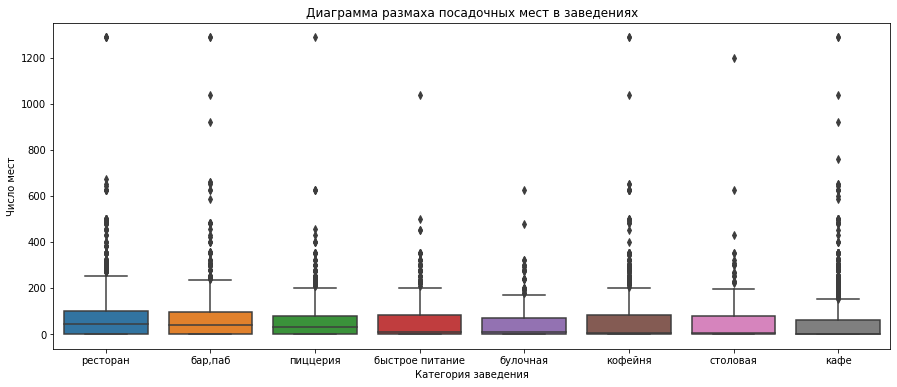

In [23]:
# Посторим диаграмму размаха со всеми выбросами, отсортировав по медиане
plt.figure(figsize=(15, 6))
(sns.boxplot(data = data, y='seats', x='category', order=data_seats_median['category'])
         .set(title = 'Диаграмма размаха посадочных мест в заведениях', 
         xlabel = 'Категория заведения', 
         ylabel = 'Число мест'))
         
plt.show()

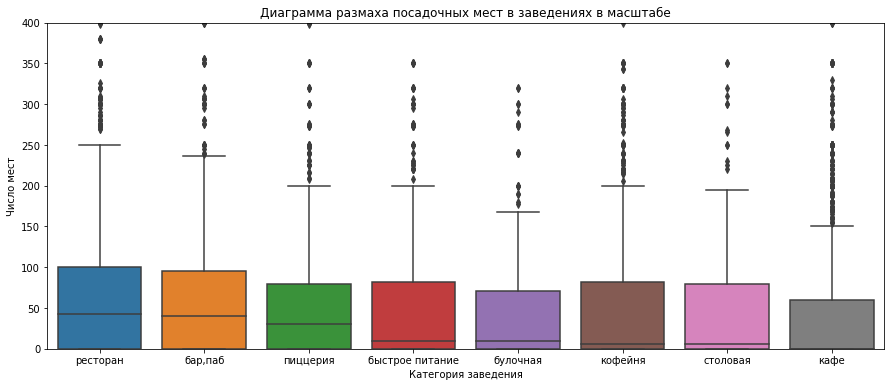

In [24]:
# Посторим масштабированную диаграмму размаха (чтобы ближе посмотреть на медианы)
plt.figure(figsize=(15, 6))
(sns.boxplot(data = data, y='seats', x='category', order=data_seats_median['category'])
         .set(title = 'Диаграмма размаха посадочных мест в заведениях в масштабе', 
         xlabel = 'Категория заведения', 
         ylabel = 'Число мест',
         ylim=(0, 400)))

plt.show()

### Рассмотрим и изобразим соотношение сетевых и несетевых заведений в датасете. Посмотрим, каких заведений больше?

In [25]:
# Сгруппируем данные по признку "сетевое заведение" и посчитаем количество
data_chain_share = data['chain'].value_counts().reset_index().rename(columns={'index':'chain', 'chain':'count'})

# Добавим столбец с долями
data_chain_share['share, %'] = (data_chain_share['count']*100 / data['chain'].count()).round()
data_chain_share

,chain,count,"share, %"
0,0,5201,62.0
1,1,3205,38.0


Несетевых заведений в Москве существенно больше:  
- 62% несетевых
- 38% сетевых

### Изучим, какие категории заведений чаще являются сетевыми. Исследуем данные и ответим на вопрос графиком.

In [26]:
# Сделаем срез сетевых заведений и посчитаем их общее количество
data.query('chain == 1')['name'].count()

3205

Всего в датасете 3205 сетевых заведений.

In [27]:
# Посчитаем в срезе сетевых заведений число заведений для каждой категории
data_chain = data.query('chain == 1')['category'].value_counts() \
.reset_index().rename(columns={'index':'category', 'category':'count'})

# Добавим столбец с долей
data_chain['share, %'] = (data_chain['count']*100 / data_chain['count'].sum()).round()
data_chain

,category,count,"share, %"
0,кафе,779,24.0
1,ресторан,730,23.0
2,кофейня,720,22.0
3,пиццерия,330,10.0
4,быстрое питание,232,7.0
5,"бар,паб",169,5.0
6,булочная,157,5.0
7,столовая,88,3.0


In [28]:
# Cтроим столбчатую диаграмму 
fig = px.bar(data_chain, # загружаем данные из датасета
             x='category', # указываем столбец с данными для оси X
             y='share, %', # указываем столбец с данными для оси Y
             text='share, %',
             hover_data=['count']) # добавляем аргумент, который отобразит текст с информацией
                           # о количестве заведений внутри столбца графика
                      
# Оформляем график
fig.update_layout(title='Распределение сетевых заведений по категориям',
                  xaxis_title='Категория',
                  yaxis_title='Доля заведений',
                  height=500, 
                  width=700)
# выводим график
fig.show() 

Среди сетевых заведений больше всего кафе 24%, ресторанов 23% и кофеен 22%.   
Меньше всего столовых - всего 3%.

In [29]:
# Посчитаем число заведений в срезе несетевых 
data_not_chain = data.query('chain == 0')['category'].value_counts() \
.reset_index().rename(columns={'index':'category', 'category':'not_chain_count'})

# Посчитаем число заведений в срезе сетевых 
data_chain = data.query('chain == 1')['category'].value_counts() \
.reset_index().rename(columns={'index':'category', 'category':'chain_count'})

# Объеденим полученные данные
merged = data_chain.merge(data_not_chain, on='category')
merged

,category,chain_count,not_chain_count
0,кафе,779,1599
1,ресторан,730,1313
2,кофейня,720,693
3,пиццерия,330,303
4,быстрое питание,232,371
5,"бар,паб",169,596
6,булочная,157,99
7,столовая,88,227


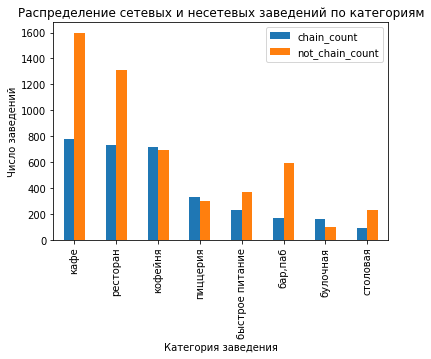

In [30]:
# Визуализируем
merged.plot(x='category', y=['chain_count', 'not_chain_count'], kind='bar')
plt.title('Распределение сетевых и несетевых заведений по категориям')
plt.xlabel('Категория заведения')
plt.ylabel('Число заведений')

plt.show()

### Сгруппируем данные по названиям заведений и найдем топ-15 популярных сетей в Москве. Под популярностью понимается количество заведений этой сети в регионе. Построим подходящую для такой информации визуализацию. Знакомы ли вам эти сети? Есть ли какой-то признак, который их объединяет? К какой категории заведений они относятся?

#### Сгруппируем данные по названиям заведений и выведем на экран топ-15 популярных сетей в Москве

In [31]:
# Сгруппируем данные сетевых заведений по названиям, посчитаем их количество и отсортируем в порядке убывания 
# Вывдем топ-15 самых популярных сетей в Москве
data_chain = data.query('chain == 1').groupby('name').agg(count=('name','count')) \
.sort_values(by='count', ascending=False).reset_index()[:15]
data_chain

,name,count
0,Шоколадница,120
1,Домино'с Пицца,76
2,Додо Пицца,74
3,One Price Coffee,71
4,Яндекс Лавка,69
5,Cofix,65
6,Prime,50
7,Хинкальная,44
8,КОФЕПОРТ,42
9,Кулинарная лавка братьев Караваевых,39


#### Визуализируем

In [32]:
# Cтроим столбчатую диаграмму 
fig = px.bar(data_chain, # загружаем данные из датасета
             x='name', # указываем столбец с данными для оси X
             y='count', # указываем столбец с данными для оси Y
             text='count') # добавляем аргумент, который отобразит текст с информацией
                           # о количестве заведений внутри столбца графика
# Оформляем график
fig.update_layout(title='Топ-15 самых популярных сетевых заведений',
                  xaxis_title='Название сети',
                  yaxis_title='Количество заведений в сети',
                  height=600, 
                  width=1000)
# выводим график
fig.show() 

Шоколадница лидирует с большим отрывом!    

На втором месте сети пиццерий Домино'с Пицца и Додо Пицца.

#### Посмотрим, что объединяет топ-15 заведений, к какой категории заведений они относятся.

In [33]:
# Составим список самых популярных сетей 
chain_top_list = data_chain['name'].tolist()

# Создадим срез топ-15 сетевых заведений 
data_chain_top = data.query('chain == 1 and name.isin(@chain_top_list)')

# Посмотрим на топ-15 сетевых заведений в разрезе категорий
data_chain_top[['name', 'category']].groupby(['name', 'category']).agg(count=('category','count')).reset_index()


,name,category,count
0,CofeFest,кафе,1
1,CofeFest,кофейня,31
2,Cofix,кофейня,65
3,One Price Coffee,кофейня,71
4,Prime,кафе,1
5,Prime,ресторан,49
6,Буханка,булочная,25
7,Буханка,кафе,1
8,Буханка,кофейня,6
9,Додо Пицца,пиццерия,74


Оказывается заведения одной сети могут принадлежать к различным категориям - владельцы заведений присваивают категорию на свое личное усмотрение. Категория заведения - это субъективный показатель. 

Например, Шоколадница - это и кафе, и кофейня. 

А вот различные заведения сети Му-Му могут относиться аж к 7 разным категриям: 

    - бар,паб  
    - быстрое питание  
    - кафе  
    - кофейня  
    - пиццерия  
    - ресторан  
    - столовая  
    

In [34]:
# Теперь посмотрим на распределение категорий заведений из топ-15
groupped_chain_top_category = data_chain_top.groupby('category').agg(count=('name','count')) \
.sort_values(by='count', ascending=False).reset_index()

# Добавим столбец с долей
groupped_chain_top_category['share, %'] = (groupped_chain_top_category['count']*100 / \
                                           groupped_chain_top_category['count'].sum()).round()

groupped_chain_top_category

,category,count,"share, %"
0,кофейня,336,41.0
1,ресторан,186,23.0
2,пиццерия,151,19.0
3,кафе,100,12.0
4,булочная,25,3.0
5,быстрое питание,12,1.0
6,"бар,паб",4,0.0
7,столовая,2,0.0


In [35]:
# Cтроим столбчатую диаграмму 
fig = px.bar(groupped_chain_top_category, # загружаем данные из датасета
             x='category', # указываем столбец с данными для оси X
             y='share, %', # указываем столбец с данными для оси Y
             text='share, %') # добавляем аргумент, который отобразит текст с информацией
                                    # о количестве заведений внутри столбца графика
                      
# Оформляем график
fig.update_layout(title='Распределение топ-15 сетевых заведений по категориям',
                  xaxis_title='Категория',
                  yaxis_title='Доля заведений',
                  height=500, 
                  width=700)
# выводим график
fig.show() 

Среди топ-15 сетевых заведений выделяются три самые популярных категории: 

- Кофейни лидируют с огромным отрывом. Кофейни - это подвид кафе, где подают напитки и десертные блюда.  

- Рестораны - почти в два раза мньше, чем кофеен.

- Пиццерии 




### Посмотрим, какие административные районы Москвы присутствуют в датасете? Отобразим общее количество заведений и количество заведений каждой категории по районам. Проиллюстрируем эту информацию одним графиком.

#### Посмотрим, какие административные районы Москвы присутствуют в датасете

In [36]:
# Посмотрим на уникальные районы
print(data['district'].unique())
print()
print('Количество районов (округов) в Москве', data['district'].nunique())

['Северный административный округ'
 'Северо-Восточный административный округ'
 'Северо-Западный административный округ'
 'Западный административный округ' 'Центральный административный округ'
 'Восточный административный округ' 'Юго-Восточный административный округ'
 'Южный административный округ' 'Юго-Западный административный округ']

Количество районов (округов) в Москве 9


#### Посмотрим на распределение количества заведений Москвы по районам 

In [37]:
# Сгруппируем данные по районам и посчитаем число заведений в каждом районе
groupped_data_district = data.groupby('district').agg(count=('name','count')) \
.sort_values(by='count', ascending=False).reset_index()

# Добавим столбец с долей
groupped_data_district['share, %'] = (groupped_data_district['count']*100 / \
                                           groupped_data_district['count'].sum()).round()

groupped_data_district

,district,count,"share, %"
0,Центральный административный округ,2242,27.0
1,Северный административный округ,900,11.0
2,Южный административный округ,892,11.0
3,Северо-Восточный административный округ,891,11.0
4,Западный административный округ,851,10.0
5,Восточный административный округ,798,9.0
6,Юго-Восточный административный округ,714,8.0
7,Юго-Западный административный округ,709,8.0
8,Северо-Западный административный округ,409,5.0


In [38]:
# Cтроим столбчатую диаграмму 
fig = px.bar(groupped_data_district, # загружаем данные из датасета
             x='district', # указываем столбец с данными для оси X
             y='share, %', # указываем столбец с данными для оси Y
             text='share, %') # добавляем аргумент, который отобразит текст с информацией
                              # о количестве заведений внутри столбца графика
                      
# Оформляем график
fig.update_layout(title='Распределение заведений Москвы по районам',
                  xaxis_title='Район',
                  yaxis_title='Доля заведений',
                  height=600, 
                  width=800)
# выводим график
fig.show() 

Больше всего заведений в центре 27%, что совершенно логично - в центе хорошая проходимость, большой поток посетителей.  
В других районах Москвы число заведений примерно одинаково.  
Исключение составляет СЗАО - всего 5% заведений. Это действительно так - я живу в СЗАО и подтверждаю, что у нас очень мало заведений общепита. 

#### Отобразим количество заведений каждой категории по районам. 

In [39]:
# Создадим сводную таблицу, в которой посчитаем количество заведений каждой категории в каждом районе
data_pivot_category_district = data.pivot_table(index='district', columns='category', values='name', aggfunc='count')
data_pivot_category_district 

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая
district,,,,,,,,
Восточный административный округ,53,25,71,272,105,72,160,40
Западный административный округ,50,37,62,239,150,71,218,24
Северный административный округ,68,39,58,235,193,77,189,41
Северо-Восточный административный округ,63,28,82,269,159,68,182,40
Северо-Западный административный округ,23,12,30,115,62,40,109,18
Центральный административный округ,364,50,87,464,428,113,670,66
Юго-Восточный административный округ,38,13,67,282,89,55,145,25
Юго-Западный административный округ,38,27,61,238,96,64,168,17
Южный административный округ,68,25,85,264,131,73,202,44


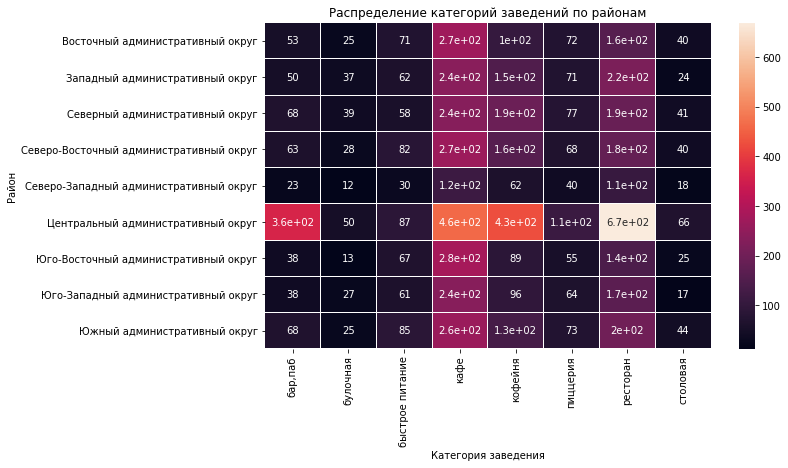

In [40]:
# Посторим тепловую карту
plt.figure(figsize=(10, 6))
sns.heatmap(data_pivot_category_district, linewidth=0.1, annot=True)

plt.xlabel("Категория заведения")
plt.ylabel("Район")
plt.title("Распределение категорий заведений по районам")
plt.show()

На хитмэпе сильно отличается от остальных полоса, соответствующая ЦАО, которая ещё раз подтверждает, что в центре города сосредоточено подавляющее большинство заведений всех категорий.  
Особенно резко выделяется белое пятно - это рестораны, две оранжевые ячейки - кафе и кофейни и ячека баров\пабов.    

Также на хитмэпе выделяется полоса для категории кафе - кафе одинаково много во всех районах города, ососбенно в ЦАО (как мы уже выяснили).

#### Добавим к таблице общее количество заведений и вновь визуализируем (такое условие в задании).

In [41]:
# Добавим новый столбец с общим числом заведений в каждом районе
data_pivot_category_district['total'] = data_pivot_category_district.sum(axis=1)
data_pivot_category_district

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая,total
district,,,,,,,,,
Восточный административный округ,53,25,71,272,105,72,160,40,798
Западный административный округ,50,37,62,239,150,71,218,24,851
Северный административный округ,68,39,58,235,193,77,189,41,900
Северо-Восточный административный округ,63,28,82,269,159,68,182,40,891
Северо-Западный административный округ,23,12,30,115,62,40,109,18,409
Центральный административный округ,364,50,87,464,428,113,670,66,2242
Юго-Восточный административный округ,38,13,67,282,89,55,145,25,714
Юго-Западный административный округ,38,27,61,238,96,64,168,17,709
Южный административный округ,68,25,85,264,131,73,202,44,892


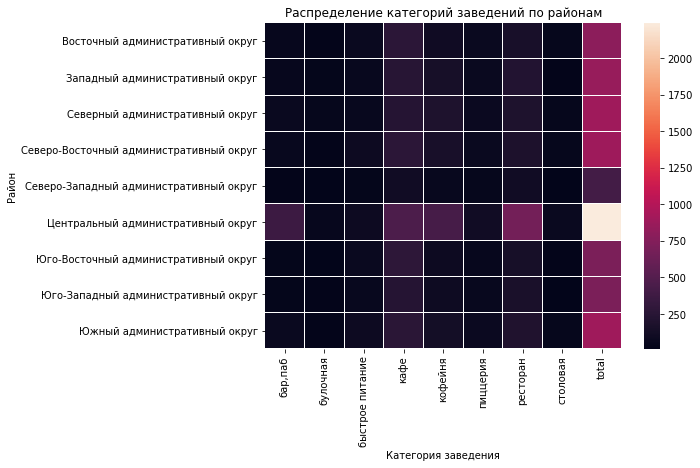

In [42]:
# Посторим тепловую карту
plt.figure(figsize=(8, 6))
sns.heatmap(data_pivot_category_district, linewidth=0.1)

plt.xlabel("Категория заведения")
plt.ylabel("Район")
plt.title("Распределение категорий заведений по районам")
plt.show()

### Визуализируем распределение средних рейтингов по категориям заведений. Сильно ли различаются усреднённые рейтинги в разных типах общепита?

In [43]:
# Посчитаем средний рейтинг для каждой категории
groupped_data_rating = data.groupby('category').agg(mean_rating=('rating', 'mean')).round(2).reset_index()
groupped_data_rating

,category,mean_rating
0,"бар,паб",4.39
1,булочная,4.27
2,быстрое питание,4.05
3,кафе,4.12
4,кофейня,4.28
5,пиццерия,4.30
6,ресторан,4.29
7,столовая,4.21


In [44]:
# Постороим круговую диаграмму 
labels = groupped_data_rating['category']
values = groupped_data_rating['mean_rating']

fig = go.Figure(data=[go.Pie(labels=labels, values=values)])
fig.update_layout(title='Распределение среднего рейтинга по категориям')
fig.show()

Рейтинги по категориям примерно одинаковы - средний рейтинг для каждой категории чуть выше 4.

### Постройм фоновую картограмму (хороплет) со средним рейтингом заведений каждого района. Границы районов Москвы, которые встречаются в датасете, хранятся в файле admin_level_geomap.geojson (скачаем  файл для локальной работы).

In [45]:
# Подготовим данные для хороплета
groupped_data_district_rating = data.groupby('district', as_index=False)['rating'].agg('mean')
groupped_data_district_rating

,district,rating
0,Восточный административный округ,4.174185
1,Западный административный округ,4.181551
2,Северный административный округ,4.239778
3,Северо-Восточный административный округ,4.148260
4,Северо-Западный административный округ,4.208802
5,Центральный административный округ,4.377520
6,Юго-Восточный административный округ,4.101120
7,Юго-Западный административный округ,4.172920
8,Южный административный округ,4.184417


In [46]:
# подключаем модуль для работы с JSON-форматом
import json

# читаем файл и сохраняем в переменной
with open('/datasets/admin_level_geomap.geojson', 'r') as f:
    geo_json = json.load(f)

# импортируем карту и хороплет
from folium import Map, Choropleth

# загружаем JSON-файл с границами округов Москвы
state_geo = '/datasets/admin_level_geomap.geojson'
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles='Cartodb Positron')

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=groupped_data_district_rating,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='RdPu',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам',
).add_to(m)

# выводим карту
m

Самый высокий рейтинг у заведний в центре, на втором месте в САО.  
Самый низкий рейтинг в ЮВА.  
Все остальные районы имеют приблизительно одинаковый рейтинг.  

### Отобразим все заведения датасета на карте с помощью кластеров средствами библиотеки folium.

In [47]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10, tiles="Cartodb Positron")
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
data.apply(create_clusters, axis=1)

# выводим карту
m

### Найдем топ-15 улиц по количеству заведений. Построим график распределения количества заведений и их категорий по этим улицам. Проиллюстрируем эту информацию одним графиком.

In [48]:
# Найдем топ-15 улиц по количеству заведений
groupped_street_top = data.groupby('street_name').agg(count=('name','count')) \
.sort_values(by='count', ascending=False).head(15).reset_index()
groupped_street_top

,street_name,count
0,проспект Мира,184
1,Профсоюзная улица,122
2,проспект Вернадского,108
3,Ленинский проспект,107
4,Ленинградский проспект,95
5,Дмитровское шоссе,88
6,Каширское шоссе,77
7,Варшавское шоссе,76
8,Ленинградское шоссе,70
9,МКАД,65


Очень много заведений общепита на проспекте Мира - 184, на втором месте Профсоюзная улица -122.

##### Подготовим данные для построения графика распределения количества заведений и их категорий по улицам из топ-15. 

In [49]:
# Создадим список топ-15 улиц по числу заведений 
street_top_list = groupped_street_top['street_name'][:15].tolist()

# Сделаем срез улиц, которые входят в топ-15 по числу заведений
data_street_top = data.query('street_name.isin(@street_top_list)')

# Посчитаем число заведений каждой категории на каждой улице из топ-15  
groupped_street_top_category = data_street_top.groupby(['street_name', 'category']) \
.agg(count=('name', 'count')).reset_index()

# Добавим новый столбец с общим числом заведений 
groupped_street_top_category['total_count'] = groupped_street_top_category.groupby('street_name')['count'].transform('sum')

# Сортируем таблицу по увеличению общего числа заведений (для корректного отображения графика, который будем строить)
groupped_street_top_category = groupped_street_top_category.sort_values(by='total_count')

groupped_street_top_category

,street_name,category,count,total_count
77,Пятницкая улица,быстрое питание,2,48
75,Пятницкая улица,"бар,паб",9,48
76,Пятницкая улица,булочная,3,48
78,Пятницкая улица,кафе,7,48
79,Пятницкая улица,кофейня,6,48
...,...,...,...,...
93,проспект Мира,кафе,53,184
92,проспект Мира,быстрое питание,21,184
90,проспект Мира,"бар,паб",12,184
96,проспект Мира,ресторан,45,184


#### Визуализируем

In [50]:
# Построим график распределения количества заведений и их категорий по улицам из топ-15

fig = px.bar(groupped_street_top_category,
             x='count',
             y='street_name',               
             color='category')

fig.update_layout(title='Распределение количества заведений и их категорий по топ-15 улицам',
                   xaxis_title='Количество заведений',
                   yaxis_title='Улица',                     
                   font=dict(size=14),
                   width=1000, 
                   height=600
                 )
fig.show()

 
На графике каждый цвет соответствует отдельной категории.  
На всех "топовых" улицах мы видим много сиреневого, розового и оранжевого - эти цвета соответствуют кафе, ресторанам и кофейням.  

### Найдем улицы, на которых находится только один объект общепита. Что можно сказать об этих заведениях?

In [51]:
# Посчитаем число заведений на каждой улице
groupped_street_name_count = data.groupby('street_name').agg(count=('name', 'count')).reset_index()

# Оставим только улицы с одним-единственным заведением
one_name_on_street = groupped_street_name_count[groupped_street_name_count['count'] == 1][['street_name', 'count']]

# Выведем таблицу с названием улицы и единственного заведения
data[data['street_name'].isin(one_name_on_street['street_name'])][['name', 'street_name']] \
.reset_index(drop=True)

,name,street_name
0,Дом обеда,улица Бусиновская Горка
1,7/12,Прибрежный проезд
2,В парке вкуснее,парк Левобережный
3,Coffeekaldi's,Угличская улица
4,Чебуречная история,ландшафтный заказник Лианозовский
...,...,...
453,Мираж,улица Шкулёва
454,WTFcoffee,улица Артюхиной
455,Беседка,Кузьминская улица
456,Лагман Хаус,Новороссийская улица


В Москве получилось 458 улиц с единственным заведением общепита.  
Скорее всего, это улицы с очень маленькой проходимостью. 

#### Проверим, сколько из 458 заведений являются сетевыми и несетевыми

In [52]:
# Найдем улицы с одним завдением (из списка, который создавали ранее) и посчитаем число уникальных значений в столбце chain
data[data['street_name'].isin(one_name_on_street['street_name'])]['chain'].value_counts()

0    325
1    133
Name: chain, dtype: int64

На улицах с единственным заведением расположены в основном несетевые заведения - 325.   
Сетевых почти в три раза меньше - 133.

#### Проверим, в каком режиме работают эти заведения

In [53]:
# Найдем улицы с одним завдением (из списка, который создавали ранее) и посчитаем число уникальных значений в столбце is_24/7
data[data['street_name'].isin(one_name_on_street['street_name'])]['is_24/7'].value_counts()

False    427
True      31
Name: is_24/7, dtype: int64

31 - круглосуточных заведений  
427 - заведений с другим режимом работы

#### Проверим, какой у них прайс

In [54]:
# Найдем улицы с одним завдением (из списка, который создавали ранее) и посчитаем число уникальных значений в столбце price
data[data['street_name'].isin(one_name_on_street['street_name'])]['price'].value_counts()

unknown          276
средние          120
выше среднего     29
высокие           22
низкие            11
Name: price, dtype: int64

В подавляющем большинстве прайс средний.  
Однако в этом столбце очень много пропусков, т.е. прайс подавляющего числа заведений остается неизвестным.  

#### Посмотрим на средний чек этих заведений

In [55]:
# Посмотрим на распределение среднего чека по районам для этих заведений 
data[data['street_name'].isin(one_name_on_street['street_name'])].groupby('district') \
.agg(middle_avg_bill=('middle_avg_bill', 'mean')).sort_values(by='middle_avg_bill', ascending=False).round()

,middle_avg_bill
district,
Северо-Западный административный округ,1434.0
Центральный административный округ,1313.0
Юго-Восточный административный округ,1094.0
Западный административный округ,770.0
Северный административный округ,730.0
Северо-Восточный административный округ,713.0
Южный административный округ,634.0
Восточный административный округ,607.0
Юго-Западный административный округ,394.0


Для улиц с единственным заведением общепита разброс среднего чека в разных районах Москвы оказался огромным:  
    - от 394 руб. на юго-западе  
    - до 1434 руб. на северо-западе 
    
Разница в 3,6 раза!

### Значения средних чеков заведений хранятся в столбце middle_avg_bill. Эти числа показывают примерную стоимость заказа в рублях, которая чаще всего выражена диапазоном. Посчитаем медиану этого столбца для каждого района. Используем это значение в качестве ценового индикатора района. Построим фоновую картограмму (хороплет) с полученными значениями для каждого района. Проанализируем цены в центральном административном округе и других. Как удалённость от центра влияет на цены в заведениях?

#### Посчитаем медиану среднего чека для каждого района

In [56]:
middle_avg_bill_median = data.groupby('district')['middle_avg_bill'].median() \
.reset_index().sort_values(by='middle_avg_bill', ascending=False)
middle_avg_bill_median

,district,middle_avg_bill
1,Западный административный округ,1000.0
5,Центральный административный округ,1000.0
4,Северо-Западный административный округ,700.0
2,Северный административный округ,650.0
7,Юго-Западный административный округ,600.0
0,Восточный административный округ,575.0
3,Северо-Восточный административный округ,500.0
8,Южный административный округ,500.0
6,Юго-Восточный административный округ,450.0


#### Построим фоновую картограмму (хороплет) 

In [57]:
# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=middle_avg_bill_median,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='Blues',
    fill_opacity=0.6,
    legend_name='Средний чек заведений по районам',
).add_to(m)

# выводим карту
m

Средний чек прямо пропорционально зависит от удаленности района от центра города, а также его престижности.  

Самый высокий средний чек в ЦАО и ЗАО - 1000 рублей. Эти районы считаются в Москве престижными.     
Самый маленький чек - на юго-востоке города (там сосредоточны объекты промзоны).  

### Проиллюстрируем другие взаимосвязи, которые мы нашли в данных. 

#### Изучим заведения с плохим рейтингом

In [58]:
# Получим срез данных по заведениям с рейтингом 1
data_low_rating = data.query('rating==1')

# Посчитаем их количество 
data_low_rating['rating'].count()

10

Заведений с рейтингом 1 всего 10 во всей Москве. 

In [59]:
# Посмотрим, в каких районах они расположены и к какой категории относятся
data_low_rating.pivot_table(index='district', columns='category', values='name', aggfunc='count')

category,кафе,пиццерия,ресторан,столовая
district,,,,
Западный административный округ,3.0,NaN,3.0,1.0
Северо-Восточный административный округ,1.0,NaN,NaN,NaN
Юго-Восточный административный округ,NaN,1.0,NaN,NaN
Юго-Западный административный округ,1.0,NaN,NaN,NaN


Заведения с рейтингом 1 расположены в четырех районах Москвы, причем 7 из 10 заведений находятся в ЗАО.      

In [60]:
# Проверим, являются ли они сетевыми
data_low_rating['chain'].value_counts()

0    7
1    3
Name: chain, dtype: int64

3 из 10 таких заведений являются стевыми.

**Вывод по шагу 3:**  

* В Москве больше всего:
    - кафе 28%
    - ресторанов 24%
    - кофеен 17%
    - очень мало столовых и булочных
    

* Разброс числа посадочных мест в заведениях разных категорий невелик:  
    - от 46 в кафе  
    - до 71 в ресторанах  
    

* Несетевых заведений существенно больше, чем сетевых:  
    - 38 % сетевых  
    - 62 % несетевых


* Среди сетевых заведений преобладают:  
    - кафе 24%  
    - ресторанов 23%  
    - кофеен 22%  
    - очень мало столовых - всего 3%  
    
 
* Топ сетевых заведений возглавляет Шоколадница, за ней следуют пиццерии Домино'с Пицца и Додо Пицца.  


* Среди топ-15 заведений Москвы выделяются три самые распространенные категории:  
    - кофейни 41%  
    - рестораны 23%  
    - пиццерии 19%  


* Больше всего заведений в центре 27%, и очень мало в СЗАО - всего 5%. 


* Рейтинги по категориям примерно одинаковы - средний рейтинг для каждой категории чуть выше 4.  


* Заведения с высоким рейтингом преимущественно расположены в центре города. 


* Больше всего заведений общепита находится на проспекте Мира. 


* В Москве 458 улиц с единственным заведением общепита. Для таких заведений средний чек отличается в 3,6 раза в зависимости от района.    


* Средний чек прямо пропорционально зависит от удаленности района от центра города, а также его престижности.  
Самый высокий средний чек в ЦАО и ЗАО - 1000 рублей. Эти районы считаются в Москве престижными.  
Самый маленький чек на юго-востоке города (там сосредоточны объекты промзоны).


## ШАГ 4. Детализируем исследование: открытие кофейни 

Основателям фонда «Shut Up and Take My Money» не даёт покоя успех сериала «Друзья». Их мечта — открыть такую же крутую и доступную, как «Central Perk», кофейню в Москве. Будем считать, что заказчики не боятся конкуренции в этой сфере, ведь кофеен в больших городах уже достаточно. Попробуем определить, осуществима ли мечта клиентов.

### Сколько всего кофеен в датасете? В каких районах их больше всего, каковы особенности их расположения?  

In [61]:
# Посчитаем число кофеен в датасете
data[data['category']=="кофейня"]['category'].count()

1413

Всего в Москве 1413 кофеен.  

In [62]:
# Посчитаем число кофеен в каждом районе
coffee_district = data.query('category=="кофейня"').groupby('district').agg(count=('category', 'count')).sort_values(by='count', ascending=False)

# Добавим столбец с долей
coffee_district['share, %'] = (coffee_district['count']*100 / \
                                           coffee_district['count'].sum()).round()
coffee_district = coffee_district.reset_index()
coffee_district

,district,count,"share, %"
0,Центральный административный округ,428,30.0
1,Северный административный округ,193,14.0
2,Северо-Восточный административный округ,159,11.0
3,Западный административный округ,150,11.0
4,Южный административный округ,131,9.0
5,Восточный административный округ,105,7.0
6,Юго-Западный административный округ,96,7.0
7,Юго-Восточный административный округ,89,6.0
8,Северо-Западный административный округ,62,4.0


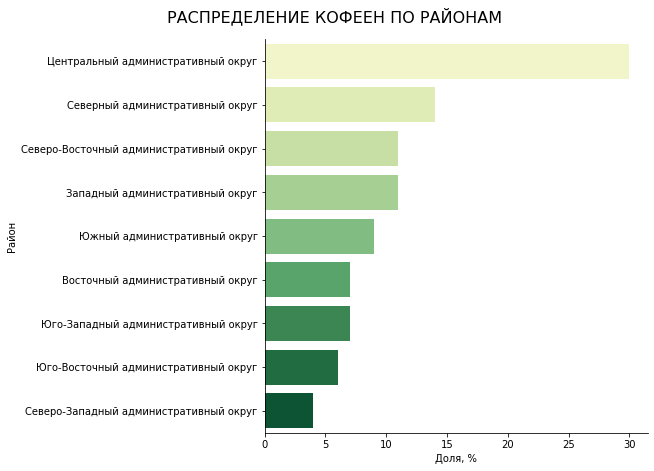

In [63]:
g = sns.catplot(data=coffee_district, kind='bar', y='district', x='share, %', palette='YlGn', height=6, aspect=1.5)
g.set_xlabels('Доля, %')
g.set_ylabels('Район')
g.fig.suptitle("РАСПРЕДЕЛЕНИЕ КОФЕЕН ПО РАЙОНАМ", fontsize=16, y=1.05)
plt.show()

Подавляющее большинство кофеен расположено в ЦАО - 30%.  
Совсем мало кофеен в СЗАО - всего 4%.  

### Есть ли круглосуточные кофейни?

In [64]:
# Посчитаем число круглосуточных кофеен 
data[(data['is_24/7']==True) & (data['category']=="кофейня")]['name'].count()

59

In [65]:
# Посчитаем долю круглосуточных кофеен 
(data[(data['is_24/7']==True) & (data['category']=="кофейня")]['name'].count()*100 / \
data[data['category']=="кофейня"]['category'].count()).round()

4.0

В Москве 59 круглосуточных кофеен, что составляет 4% от общего числа кофеен в Москве.

### Какие у кофеен рейтинги? Как они распределяются по районам?

In [66]:
# Сгруппируем кофейни по районам, после чего в каждом районе посчитаем средний рейтинг заведений 
coffee_rating = data.query('category=="кофейня"').groupby('district')['rating'].mean() \
.reset_index().round(2).sort_values(by='rating', ascending=False)
coffee_rating 

,district,rating
5,Центральный административный округ,4.34
4,Северо-Западный административный округ,4.33
2,Северный административный округ,4.29
0,Восточный административный округ,4.28
7,Юго-Западный административный округ,4.28
6,Юго-Восточный административный округ,4.23
8,Южный административный округ,4.23
3,Северо-Восточный административный округ,4.22
1,Западный административный округ,4.20


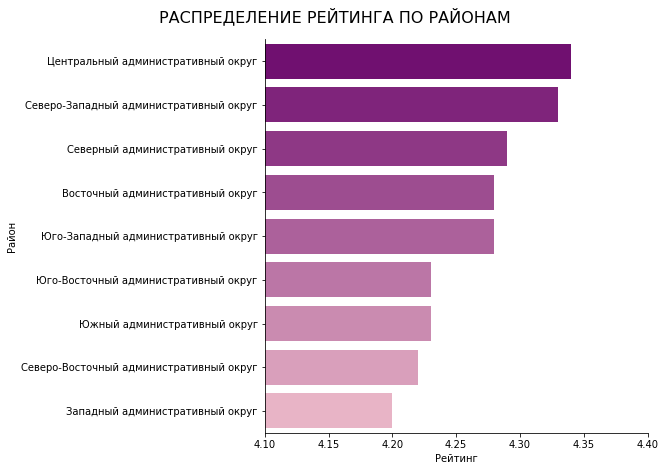

In [67]:
palette = sns.blend_palette(['purple', 'pink'], n_colors=10)

g = sns.catplot(data=coffee_rating, kind='bar', y='district', x='rating', palette=palette, height=6, aspect=1.5)
g.set_xlabels('Рейтинг')
g.set_ylabels('Район')
g.fig.suptitle("РАСПРЕДЕЛЕНИЕ РЕЙТИНГА ПО РАЙОНАМ", fontsize=16, y=1.05)
g.set(xlim=(4.1, 4.4))
plt.show()

Рейтинги кофеен по районам отличаются друг от друга не сильно, для того чтобы разглядеть разницу пришлось даже увеличивать масштаб.  
Самый высокий рейтинг в центре (4.34), самый низкий - в западном округе (4.20). 

### На какую стоимость чашки капучино стоит ориентироваться при открытии и почему?

In [68]:
# Найдем минимальную стоимость чашки кофе в Москве
data.query('category=="кофейня"')['middle_coffee_cup'].min()

60.0

Самая дешевое кофе стоит 60 рублей - вполне вероятная цена.  

In [69]:
# Найдем максимальную стоимость чашки кофе в Москве
data.query('category=="кофейня"')['middle_coffee_cup'].max()

1568.0

Самое дорогое кофе стоит 1568 рублей.   
Теоретически это возможно, если кофе приготовлено из дорогого сорта и подается в элитном ресторане. 
В любом случае, это выброс и перед дальнейшим исследованием от него лучше избавиться. 

In [70]:
# Сделаем срез, удалив выпадающее значение стоимости чашки кофе
coffee_middle_coffee_cup = data.query('category=="кофейня" & middle_coffee_cup < 1568')

# Сгруппируем данные по районам и посчитаем сдеднее значение стоимости чашки кофе для каждого района
coffee_middle_coffee_cup = (coffee_middle_coffee_cup.groupby('district').agg(middle_coffee_cup=('middle_coffee_cup', 'mean')) \
.reset_index().sort_values(by='middle_coffee_cup', ascending=False)).round()


# Посчитаем отностительные величины среднего чека к к максимальному значению 
coffee_middle_coffee_cup['middle_coffee_cup_share, %'] = (coffee_middle_coffee_cup['middle_coffee_cup']*100 / \
                                   coffee_middle_coffee_cup['middle_coffee_cup'].max()).round(2)
coffee_middle_coffee_cup

,district,middle_coffee_cup,"middle_coffee_cup_share, %"
1,Западный административный округ,190.0,100.00
5,Центральный административный округ,188.0,98.95
7,Юго-Западный административный округ,184.0,96.84
2,Северный административный округ,166.0,87.37
4,Северо-Западный административный округ,166.0,87.37
3,Северо-Восточный административный округ,165.0,86.84
8,Южный административный округ,158.0,83.16
6,Юго-Восточный административный округ,151.0,79.47
0,Восточный административный округ,140.0,73.68


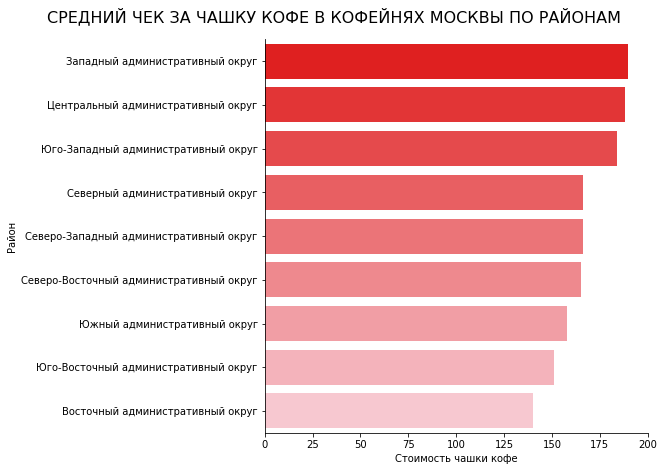

In [71]:
palette = sns.blend_palette(['red', 'pink'], n_colors=9)

g = sns.catplot(data=coffee_middle_coffee_cup, kind='bar', y='district', x='middle_coffee_cup', palette=palette, height=6, aspect=1.5)
g.set_xlabels('Стоимость чашки кофе')
g.set_ylabels('Район')
g.fig.suptitle("СРЕДНИЙ ЧЕК ЗА ЧАШКУ КОФЕ В КОФЕЙНЯХ МОСКВЫ ПО РАЙОНАМ", fontsize=16, y=1.05)
g.set(xlim=(0, 200))
plt.show()



Разброс значений чашки кофе для разных районов Москвы достаточно велик - от 140 до 190 рублей.  
Среди районов для кофеен выявился лидер по чеку за кофе - это ЗАО, но ЦАО отстает от лидера совсем незначительно.  

Чтобы ответить на вопрос, на какую стоимость чашки кофе стоит ориентироваться при открытии кофейни, нужно помочь инвесторам определиться с выбором района для открытия заведения. 

### Собственное исследование

#### Среди кофеен найдем районы с самым высоким средним чеком счета

Ранее мы выяснили, что самый высокий средний чек за чашку кофе в заведениях ЗАО.  
Теперь точно также посмотрим на средний чек счета с разбивкой по районам Москвы.  

In [72]:
# Найдем минимальный средний чек счета в Москве
data.query('category=="кофейня"')['middle_avg_bill'].min()

0.0

In [73]:
# Найдем максимальный средний чек счета в Москве
data.query('category=="кофейня"')['middle_avg_bill'].max()

2500.0

Максимальный средний чек счета в кофейнях не впечатляет - всего 2500 рублей.

In [74]:
# Для расчета среднего чека берем медиану, чтобы не учитвать выбросы
coffee_middle_avg_bill = data.query('category=="кофейня"').groupby('district') \
.agg(middle_avg_bill=('middle_avg_bill', 'mean')).sort_values(by='middle_avg_bill', ascending=False)

# Посчитаем отностительные величины среднего чекак к максимальному значению 
coffee_middle_avg_bill['middle_avg_bill_share, %'] = (coffee_middle_avg_bill['middle_avg_bill']*100 / \
                                   coffee_middle_avg_bill['middle_avg_bill'].max()).round(2)
coffee_middle_avg_bill

,middle_avg_bill,"middle_avg_bill_share, %"
district,,
Центральный административный округ,794.764706,100.00
Западный административный округ,694.444444,87.38
Южный административный округ,504.777778,63.51
Северный административный округ,495.736842,62.38
Восточный административный округ,486.111111,61.16
Северо-Западный административный округ,440.636364,55.44
Северо-Восточный административный округ,433.157895,54.50
Юго-Западный административный округ,381.818182,48.04
Юго-Восточный административный округ,263.000000,33.09


Самый высокий средний чек счета в кофейнях ЦАО, на втром месте ЗАО.    

У ЗАО опять неплохой результат!   
Но в кофейнях всё-таки надо ориентироваться на средний чек за чашку кофе.  

#### Для наглядности объединим информацию по средним чекам счета и чашки кофе в одну таблицу

In [75]:
# Соберем в одну таблицу следующую информациюmerged_data: средний чек счета и средний чек за чашку кофе
merged_data = coffee_middle_avg_bill.merge(coffee_middle_coffee_cup, on='district')
merged_data.loc[:, ['district', 'middle_avg_bill_share, %', 'middle_coffee_cup_share, %']]

,district,"middle_avg_bill_share, %","middle_coffee_cup_share, %"
0,Центральный административный округ,100.00,98.95
1,Западный административный округ,87.38,100.00
2,Южный административный округ,63.51,83.16
3,Северный административный округ,62.38,87.37
4,Восточный административный округ,61.16,73.68
5,Северо-Западный административный округ,55.44,87.37
6,Северо-Восточный административный округ,54.50,86.84
7,Юго-Западный административный округ,48.04,96.84
8,Юго-Восточный административный округ,33.09,79.47


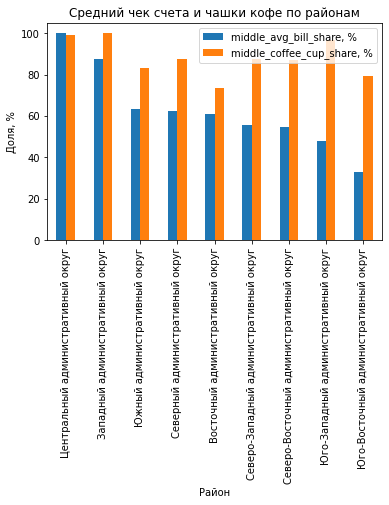

In [76]:
merged_data.plot(x='district', y=['middle_avg_bill_share, %', 'middle_coffee_cup_share, %'], kind='bar')
plt.title('Средний чек счета и чашки кофе по районам')
plt.xlabel('Район')
plt.ylabel('Доля, %')

plt.show()

Средний чек - важный показатель для инвесторов.   

По суммам среднего чека наиболее перспективными для открытия кофейни являются ЦАО и ЗАО.  
Присмотримся кэтим районам повнимательнее.   

#### Изучим конкуренцию по районам - посмотрим на распределение кофеен по районам Москвы

In [77]:
coffee_district = data.query('category=="кофейня"').groupby('district').agg(count=('name', 'count')) \
.sort_values(by='count', ascending=False).reset_index()

# Посчитаем отностительные величины среднего чекак к максимальному значению 
coffee_district['share, %'] = (coffee_district['count']*100 / \
                                   coffee_district['count'].max()).round(2)
coffee_district

,district,count,"share, %"
0,Центральный административный округ,428,100.00
1,Северный административный округ,193,45.09
2,Северо-Восточный административный округ,159,37.15
3,Западный административный округ,150,35.05
4,Южный административный округ,131,30.61
5,Восточный административный округ,105,24.53
6,Юго-Западный административный округ,96,22.43
7,Юго-Восточный административный округ,89,20.79
8,Северо-Западный административный округ,62,14.49


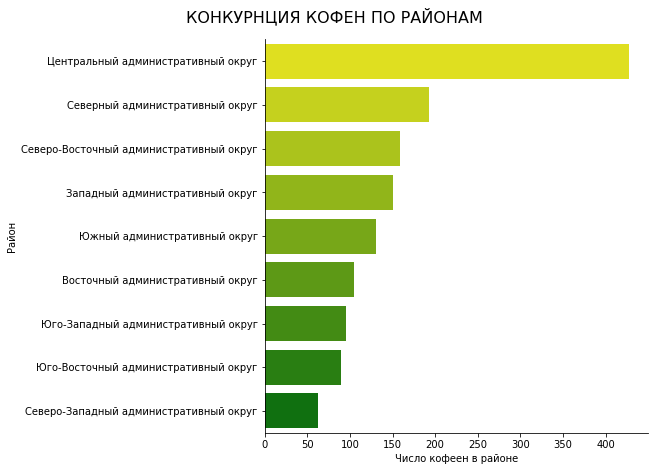

In [78]:
palette = sns.blend_palette(['yellow', 'green'], n_colors=9)

g = sns.catplot(data=coffee_district, kind='bar', y='district', x='count', palette=palette, height=6, aspect=1.5)
g.set_xlabels('Число кофеен в районе')
g.set_ylabels('Район')
g.fig.suptitle("КОНКУРНЦИЯ КОФЕН ПО РАЙОНАМ", fontsize=16, y=1.05)

plt.show()


Конкуренция в ЦАО огромна - в центральном округе сосредоточено 458 кофеен. 

Конкуренция среди кофеен в ЗАО почти в три раза меньше - всего 150 кофеен на район.  
Однако логично предположить, что поток посетителей в ЗАО тоже ниже.    

**Рекомендуем инвесторам повнимательнее присмотреться к Западному району города:** 

**Преимущества ЗАО по сравнению с ЦАО:**
- Самый высокий средний чек за чашку кофе 
- Не такой высокий уровень конкуренции  

**Недостатки ЗАО по сравнению с ЦАО:**  
- Поток посетителей меньше 

#### Посмотрим в лицо конкурентам - найдем топ-10 кофеен, расположенных в ЗАО

In [79]:
# Сделаем нужный срез, сгруппируем кофейни по названиям, посчитаем их количество, отсортируем в порядке убывания 
# Вывдем топ-10 самых популярных кофеен в ЗАО
data_coffee_top_zao = data.query('category=="кофейня" & district=="Западный административный округ"').groupby('name') \
.agg(count=('name','count')).sort_values(by='count', ascending=False).reset_index()[:10]
data_coffee_top_zao 

,name,count
0,Шоколадница,17
1,One Price Coffee,9
2,КОФЕПОРТ,7
3,Cinnabon,5
4,Кофемания,4
5,Cofix,4
6,CofeFest,3
7,Wild Bean,2
8,Кофейня,2
9,Star Hit Cafe,2


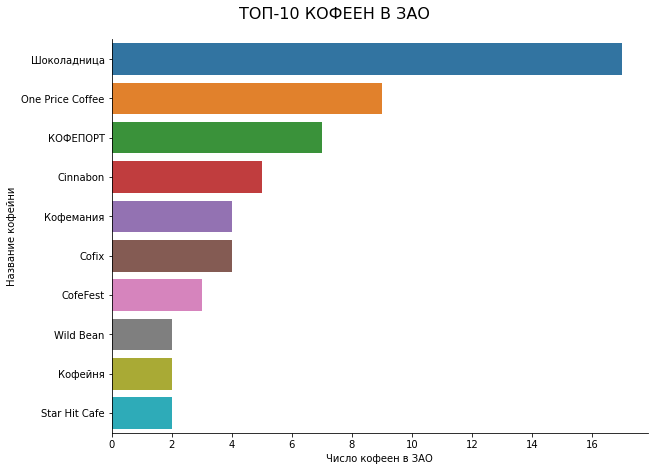

In [80]:
# Визуализируем

g = sns.catplot(data=data_coffee_top_zao, kind='bar', y='name', x='count', height=6, aspect=1.5)
g.set_xlabels('Число кофеен в ЗАО')
g.set_ylabels('Название кофейни')
g.fig.suptitle("ТОП-10 КОФЕЕН В ЗАО", fontsize=16, y=1.05)

plt.show()

#### Найдем топ-10 улиц ЗАО с самым большим числом кофен

In [81]:
# Найдем топ-10 улиц ЗАО по количеству заведений
coffee__zao_street_top = data.query('category=="кофейня" & district=="Западный административный округ"') \
.groupby('street_name').agg(count=('name','count')).sort_values(by='count', ascending=False).head(10).reset_index()
coffee__zao_street_top 

,street_name,count
0,проспект Вернадского,16
1,Кутузовский проспект,13
2,Береговой проезд,9
3,Ярцевская улица,8
4,площадь Киевского Вокзала,6
5,Верейская улица,6
6,Мосфильмовская улица,5
7,Ломоносовский проспект,5
8,Рублёвское шоссе,5
9,улица Барклая,5


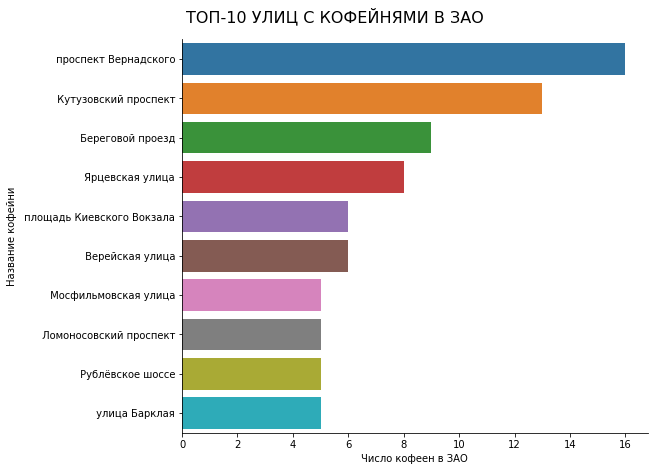

In [82]:
# Визуализируем

g = sns.catplot(data=coffee__zao_street_top, kind='bar', y='street_name', x='count', height=6, aspect=1.5)
g.set_xlabels('Число кофеен в ЗАО')
g.set_ylabels('Название кофейни')
g.fig.suptitle("ТОП-10 УЛИЦ С КОФЕЙНЯМИ В ЗАО", fontsize=16, y=1.05)

plt.show()


Лидером по числу кофеен в ЗАО оказался проспект Вернадского - там расположено целых 16 кофеен, на втором месте Кутузовский проспект - 13 кофеен.

#### Посмотрим на распределение по часам работы для кофеен, расположенных в ЗАО

In [83]:
data_day_night_zao = data.query('category=="кофейня" & district=="Западный административный округ"')['is_24/7'] \
.value_counts().reset_index().rename(columns={'index':'is_24/7', 'is_24/7':'count'})

data_day_night_zao

,is_24/7,count
0,False,141
1,True,9


В ЗАО очень мало круглосуточных кофеен, впрочем как и по городу в целом.  
Из 150 кофеен всего 9 круглосуточные. 

#### Посчитаем, сколько сетевых кофеен расположено в ЗАО

In [84]:
data_chain_zao = data.query('category=="кофейня" & district=="Западный административный округ"')['chain'] \
.value_counts().reset_index().rename(columns={'index':'chain', 'chain':'count'})

data_chain_zao

,chain,count
0,1,93
1,0,57


Среди кофеен, расположенных в ЗАО, 93 сетевых заведения и 57 несетевых. 

#### Посчитаем, сколько в среднем посадочнх мест расположено в ЗАО

In [85]:
data.query('category=="кофейня" & district=="Западный административный округ"')['seats'].mean().round() 


93.0

В среднем в кофейнях ЗАО 93 посадочных мест.  

## ШАГ 5. Подготовка презентации

При подготовке презентации исходим из того, что заказчик уже определился с выбором категории заведения - это кофейня, похожая на «Central Perk» из сериала «Друзья».

Ссылка на презентацию: <https://disk.yandex.com.am/i/N8V8sA9AmUzDcQ>
  